In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Exploration New Plant Diseases Dataset : Maladie des plantes

In [ ]:
%cd /content/drive/MyDrive/Dataset_projet/Maladie sur les plantes/New Plant Diseases/New Plant Diseases Dataset(Augmented)/train

/content/drive/MyDrive/Dataset_projet/Maladie sur les plantes/New Plant Diseases/New Plant Diseases Dataset(Augmented)/train


In [ ]:
import pandas as pd
import os

In [ ]:
path_folder = "/content/drive/MyDrive/Dataset_projet/Maladie sur les plantes/New Plant Diseases/New Plant Diseases Dataset(Augmented)/train"

In [ ]:


# Liste pour stocker les chemins des fichiers avec leurs labels
file_labels = []

# Parcourir chaque sous-dossier de classe et récupérer le chemin de chaque fichier avec son label
for class_folder in os.listdir(path_folder):
    class_path = os.path.join(path_folder, class_folder)
    if os.path.isdir(class_path):
        for file in os.listdir(class_path):
            file_path = os.path.join(class_path, file)
            label = class_folder
            file_labels.append((file_path, label))

# Créer un dataframe à partir de la liste des fichiers et des labels
df = pd.DataFrame(file_labels, columns=["path_folder", "label"])

# Afficher le dataframe
print(df.head())


                                         path_folder  \
0  /content/drive/MyDrive/Dataset_projet/Maladie ...   
1  /content/drive/MyDrive/Dataset_projet/Maladie ...   
2  /content/drive/MyDrive/Dataset_projet/Maladie ...   
3  /content/drive/MyDrive/Dataset_projet/Maladie ...   
4  /content/drive/MyDrive/Dataset_projet/Maladie ...   

                                      label  
0  Cherry_(including_sour)___Powdery_mildew  
1  Cherry_(including_sour)___Powdery_mildew  
2  Cherry_(including_sour)___Powdery_mildew  
3  Cherry_(including_sour)___Powdery_mildew  
4  Cherry_(including_sour)___Powdery_mildew  


**Distribtution des classes**

Soybean___healthy                                     2022
Apple___Apple_scab                                    2016
Orange___Haunglongbing_(Citrus_greening)              2010
Apple___healthy                                       2008
Pepper,_bell___healthy                                1988
Apple___Black_rot                                     1987
Tomato___Tomato_Yellow_Leaf_Curl_Virus                1961
Potato___Late_blight                                  1939
Potato___Early_blight                                 1939
Tomato___healthy                                      1926
Tomato___Early_blight                                 1920
Grape___Esca_(Black_Measles)                          1920
Pepper,_bell___Bacterial_spot                         1913
Corn_(maize)___Northern_Leaf_Blight                   1909
Corn_(maize)___Common_rust_                           1907
Grape___Black_rot                                     1888
Tomato___Leaf_Mold                                    18

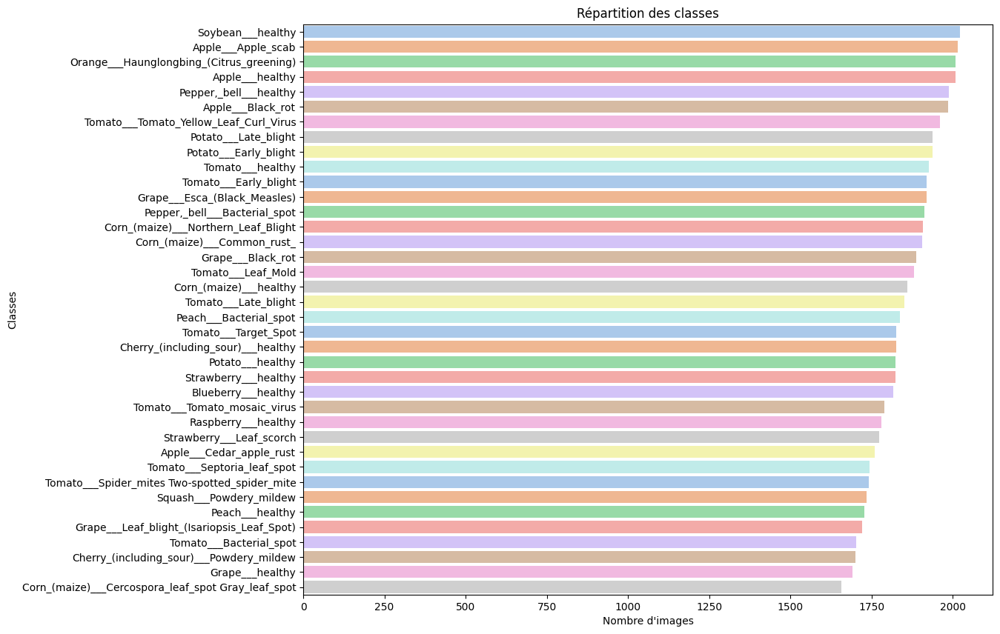

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

# Obtenir la distribution des classes en comptant le nombre d'éléments dans chaque classe
class_distribution = df['label'].value_counts()

# Afficher la distribution des classes
print(class_distribution)

# Afficher un graphique en barres montrant la répartition des classes
colors = sns.color_palette('pastel')

fig, ax = plt.subplots(figsize=(12, 10))
sns.barplot(x=class_distribution, y=class_distribution.index, palette=colors, ax=ax)


ax.set_title('Répartition des classes')
ax.set_ylabel('Classes')
ax.set_xlabel('Nombre d\'images')

plt.show()

**Encodage**

In [ ]:
import os
import numpy as np
from PIL import Image

extensions = ('.jpg', '.jpeg', '.png')

encodings = set()

for dirpath, dirnames, filenames in os.walk(path_folder):
    for filename in filenames:
        if filename.lower().endswith(extensions):
            img = Image.open(os.path.join(dirpath, filename))
            encoding = img.mode
            encodings.add(encoding)

            encodings_array = np.array(encodings)

# Affichage de l'encodage général des images
encoding_general = np.unique(encodings_array)
print('L\'encodage général des images est :', encoding_general)

L'encodage général des images est : [{'RGB'}]


**Graphique représentant la taille des images**

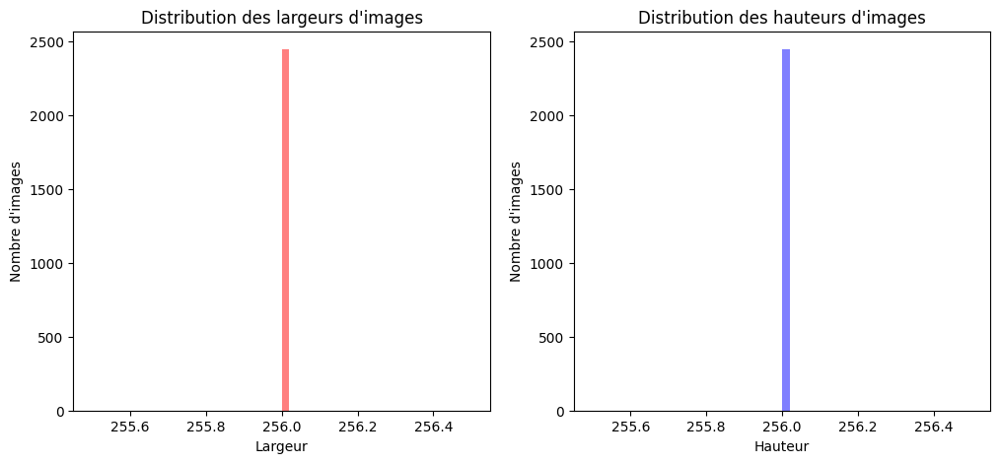

In [ ]:
# Déterminer la taille des images contenues dans chaque dossier

import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# Chemin du dossier contenant les images
path_folder = "/content/drive/MyDrive/Dataset_projet/Maladie sur les plantes/New Plant Diseases/New Plant Diseases Dataset(Augmented)/train"

# Initialisation d'une liste pour stocker les tailles des images
tailles_images = []

# Parcourir le dossier et obtenir la taille de chaque image
for root, dirs, files in os.walk(path_folder):
    for filename in files:
        if filename.endswith(".jpg"):
            image_path = os.path.join(root, filename)
            with Image.open(image_path) as image:
                largeur, hauteur = image.size
                tailles_images.append((largeur, hauteur))

if len(tailles_images) > 0:
    # Convertir la liste en tableau numpy
    tailles_images_np = np.array(tailles_images)

    # Afficher la distribution des tailles d'images avec un histogramme
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,5))

    ax1.hist(tailles_images_np[:,0], bins=50, alpha=0.5, color='r', label='Largeur')
    ax1.set_xlabel('Largeur')
    ax1.set_ylabel('Nombre d\'images')
    ax1.set_title('Distribution des largeurs d\'images')

    ax2.hist(tailles_images_np[:,1], bins=50, alpha=0.5, color='b', label='Hauteur')
    ax2.set_xlabel('Hauteur')
    ax2.set_ylabel('Nombre d\'images')
    ax2.set_title('Distribution des hauteurs d\'images')

    plt.show()

**Statistiques sur les pixels**

In [ ]:
import numpy as np
from PIL import Image
import os


# Initialiser les tableaux pour stocker les pixels de toutes les images
pixels = []

# Parcourir tous les fichiers dans le dossier et charger les images
for foldername in os.listdir(path_folder):
    folderpath = os.path.join(path_folder, foldername)
    for filename in os.listdir(folderpath):
        filepath = os.path.join(folderpath, filename)
        if filepath.endswith(".jpg") or filepath.endswith(".jpeg") or filepath.endswith(".png"):
            # Charger l'image en tant que tableau numpy
            image = Image.open(filepath)
            pixel_values = np.array(image)

            # Ajouter les pixels à la liste de pixels
            pixels.append(pixel_values)

# Convertir la liste de pixels en tableau numpy
pixels = np.array(pixels)

# Calculer la moyenne, l'écart type et la plage des pixels
mean_pixels = np.mean(pixels)
std_pixels = np.std(pixels)
min_pixels = np.min(pixels)
max_pixels = np.max(pixels)

print("Moyenne des pixels :", mean_pixels)
print("Écart type des pixels :", std_pixels)
print("Plage des pixels :", min_pixels, "-", max_pixels)


Moyenne des pixels : 126.3152712525894
Écart type des pixels : 55.206385308482425
Plage des pixels : 0 - 255


**Histogramme de l'intensité des images en fonction des classes**

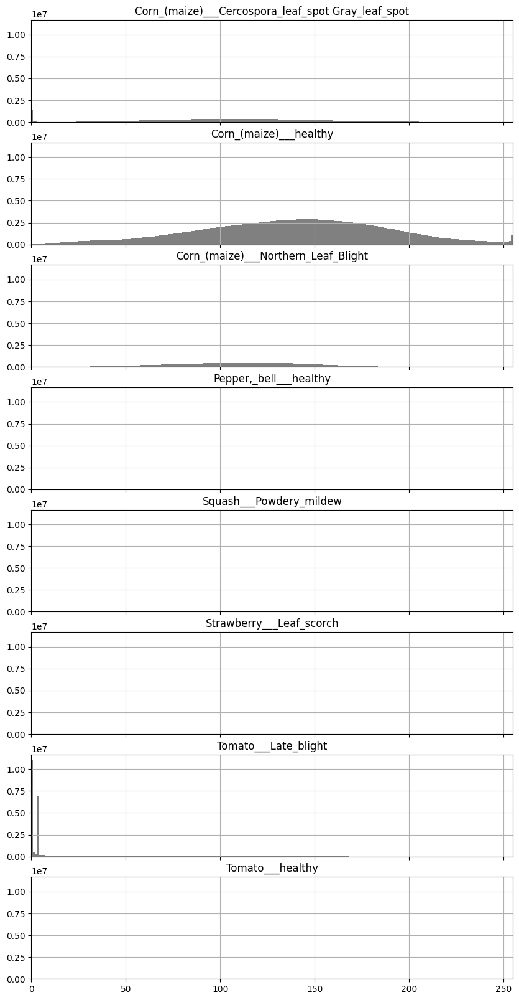

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Chemin du dossier contenant les images
path_folder = "/content/drive/MyDrive/Dataset_projet/Maladie sur les plantes/New Plant Diseases/New Plant Diseases Dataset(Augmented)/train"

# Dictionnaire pour stocker les intensités des pixels de chaque classe
intensites_par_classe = {}

# Parcourir le dossier et obtenir l'intensité des pixels de chaque image
for root, dirs, files in os.walk(path_folder):
    for filename in files:
        if filename.endswith(".jpg"):
            image_path = os.path.join(root, filename)
            # Obtenir le nom de la classe à partir du chemin
            classe = os.path.basename(root)
            with Image.open(image_path) as image:
                # Obtenir l'intensité des pixels de l'image
                intensites = np.array(image).ravel()
                # Ajouter les intensités à la classe correspondante dans le dictionnaire
                if classe in intensites_par_classe:
                    intensites_par_classe[classe] = np.concatenate((intensites_par_classe[classe], intensites))
                else:
                    intensites_par_classe[classe] = intensites

# Afficher l'histogramme de l'intensité des pixels pour chaque classe
fig, axs = plt.subplots(nrows=len(intensites_par_classe), sharex=True, sharey=True, figsize=(10, 20))
for i, (classe, intensites) in enumerate(intensites_par_classe.items()):
    axs[i].hist(intensites, bins=256, color='gray')
    axs[i].set_title(classe)
    axs[i].set_xlim([0, 255])
    axs[i].grid(True)

plt.show()

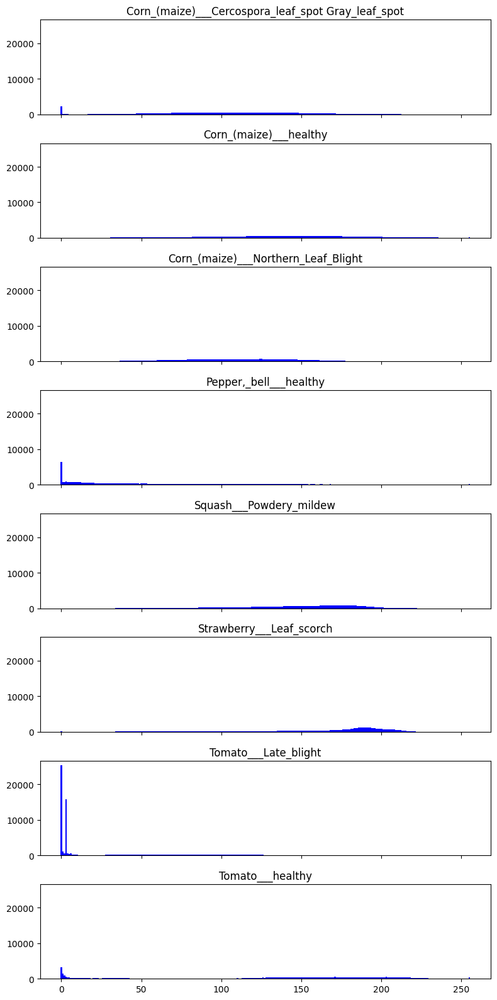

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# Chemin du dossier contenant les images
path_folder = "/content/drive/MyDrive/Dataset_projet/Maladie sur les plantes/New Plant Diseases/New Plant Diseases Dataset(Augmented)/train"

# Initialisation d'un dictionnaire pour stocker les histogrammes d'intensité par classe
hist_dict = {}

# Parcourir le dossier et obtenir les intensités de chaque image
for class_folder in os.listdir(path_folder):
    class_path = os.path.join(path_folder, class_folder)
    if os.path.isdir(class_path):
        intensites = []
        for filename in os.listdir(class_path):
            if filename.endswith(".jpg"):
                image_path = os.path.join(class_path, filename)
                with Image.open(image_path) as image:
                    intensites.append(np.array(image.histogram()))

        if len(intensites) > 0:
            # Convertir la liste en tableau numpy
            intensites_np = np.array(intensites)

            # Calculer la moyenne des intensités pour chaque classe
            hist_dict[class_folder] = np.mean(intensites_np.reshape((-1, 256)), axis=0)

# Afficher l'histogramme pour chaque classe
fig, ax = plt.subplots(nrows=len(hist_dict), sharex=True, sharey=True, figsize=(8, 16))
for i, (class_name, hist) in enumerate(hist_dict.items()):
    ax[i].bar(range(256), hist, width=1, color='blue')
    ax[i].set_title(class_name)

plt.tight_layout()
plt.show()

**Histogramme de l'intensité des images de chaque classe**

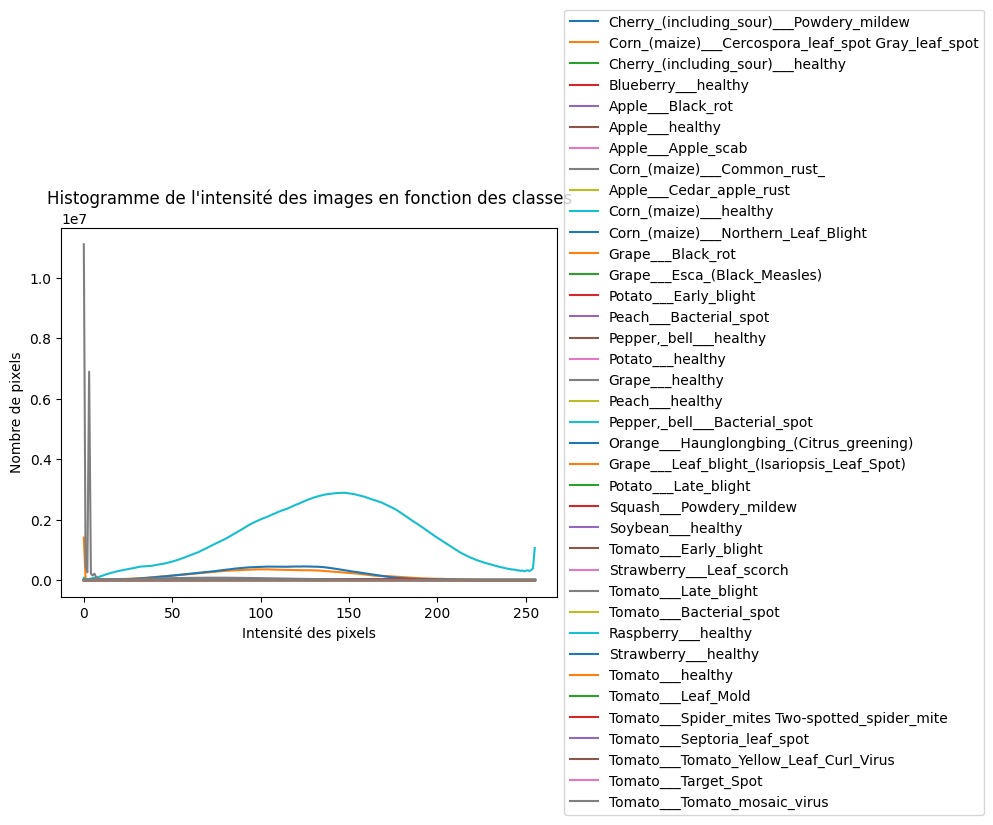

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# Définir le chemin du dossier contenant les images
path_folder = "/content/drive/MyDrive/Dataset_projet/Maladie sur les plantes/New Plant Diseases/New Plant Diseases Dataset(Augmented)/train"

# Initialiser un dictionnaire pour stocker les histogrammes de chaque classe
hist_dict = {}

# Parcourir les sous-dossiers et obtenir les histogrammes de chaque classe
for class_folder in os.listdir(path_folder):
    if not class_folder.startswith('.'):
        # Initialiser un tableau pour stocker les intensités de chaque image dans la classe
        intensites = np.array([])

        # Parcourir les fichiers d'images dans le dossier de la classe
        for filename in os.listdir(os.path.join(path_folder, class_folder)):
            if filename.endswith(".jpg"):
                image_path = os.path.join(path_folder, class_folder, filename)
                with Image.open(image_path) as image:
                    # Obtenir les valeurs des pixels de l'image
                    pixels = np.array(image)
                    # Obtenir les valeurs des canaux RGB pour chaque pixel
                    intensite_pixel = pixels.reshape(-1, 3)
                    # Ajouter les valeurs d'intensité à la liste
                    intensites = np.concatenate((intensites, intensite_pixel[:, 0], intensite_pixel[:, 1], intensite_pixel[:, 2]))

        # Calculer l'histogramme moyen de l'intensité pour la classe
        hist_dict[class_folder] = np.histogram(intensites, bins=256, range=(0, 256))[0]

# Créer une figure et des axes
fig, ax = plt.subplots()

# Afficher les histogrammes pour chaque classe
for class_folder, hist in hist_dict.items():
    plt.plot(hist, label=class_folder)

# Définir la position de la légende en dehors de la figure
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

plt.title('Histogramme de l\'intensité des images en fonction des classes')
plt.xlabel('Intensité des pixels')
plt.ylabel('Nombre de pixels')
plt.show()

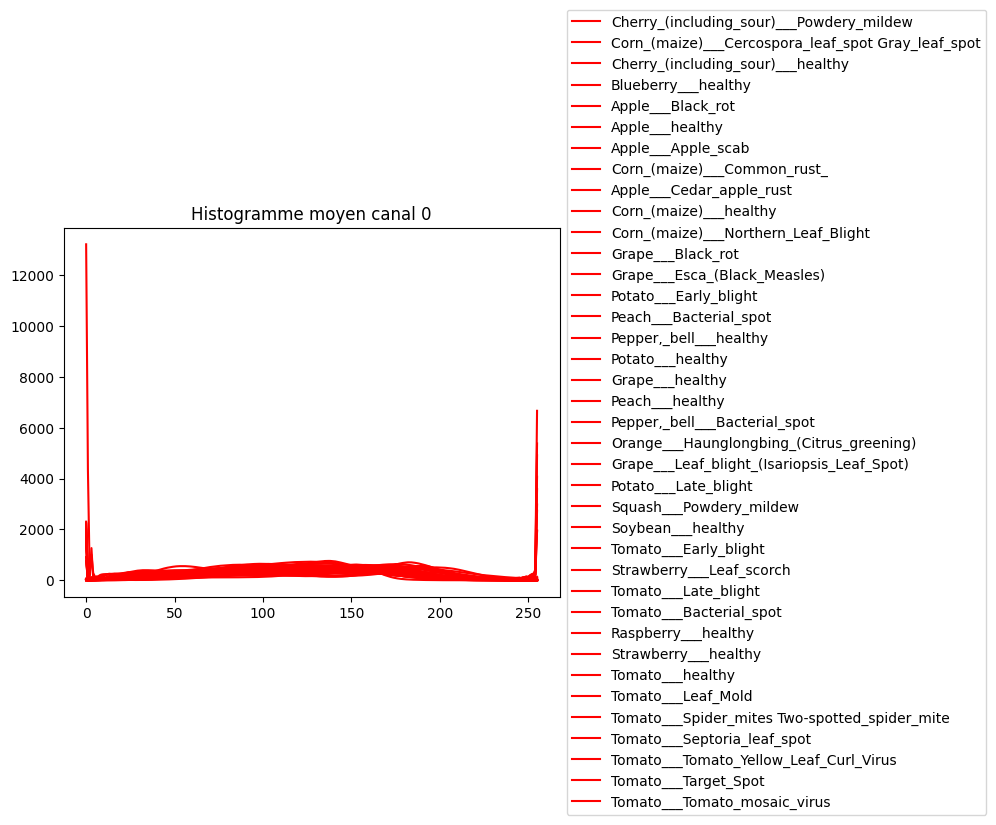

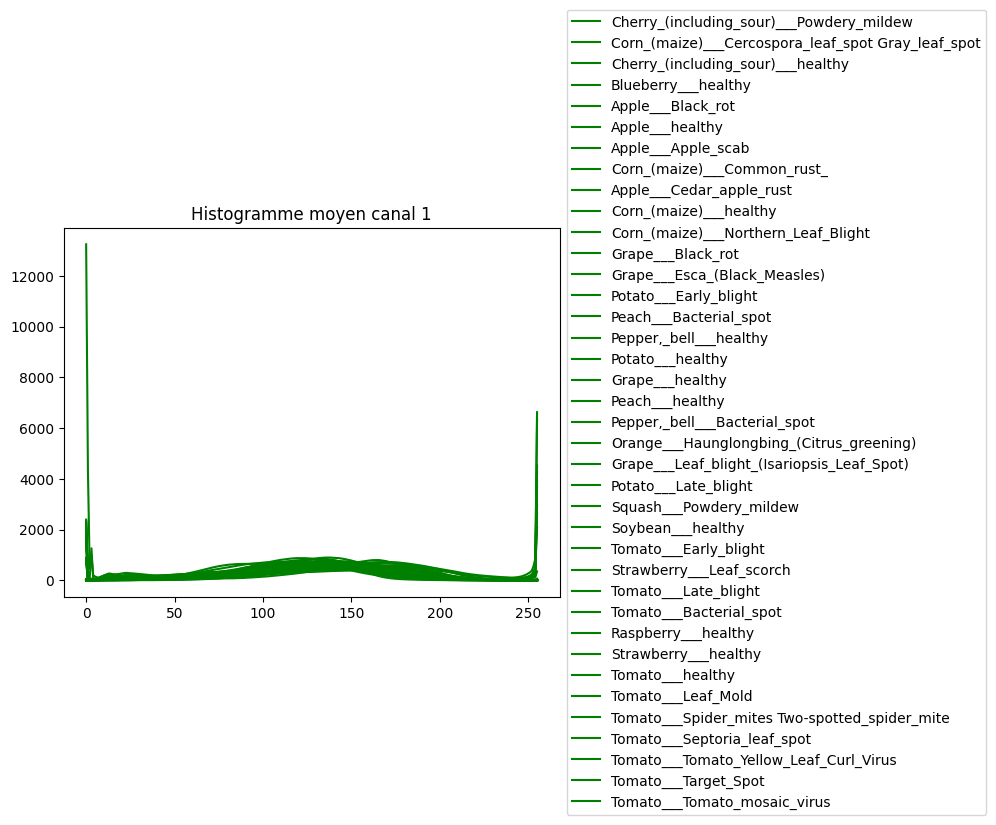

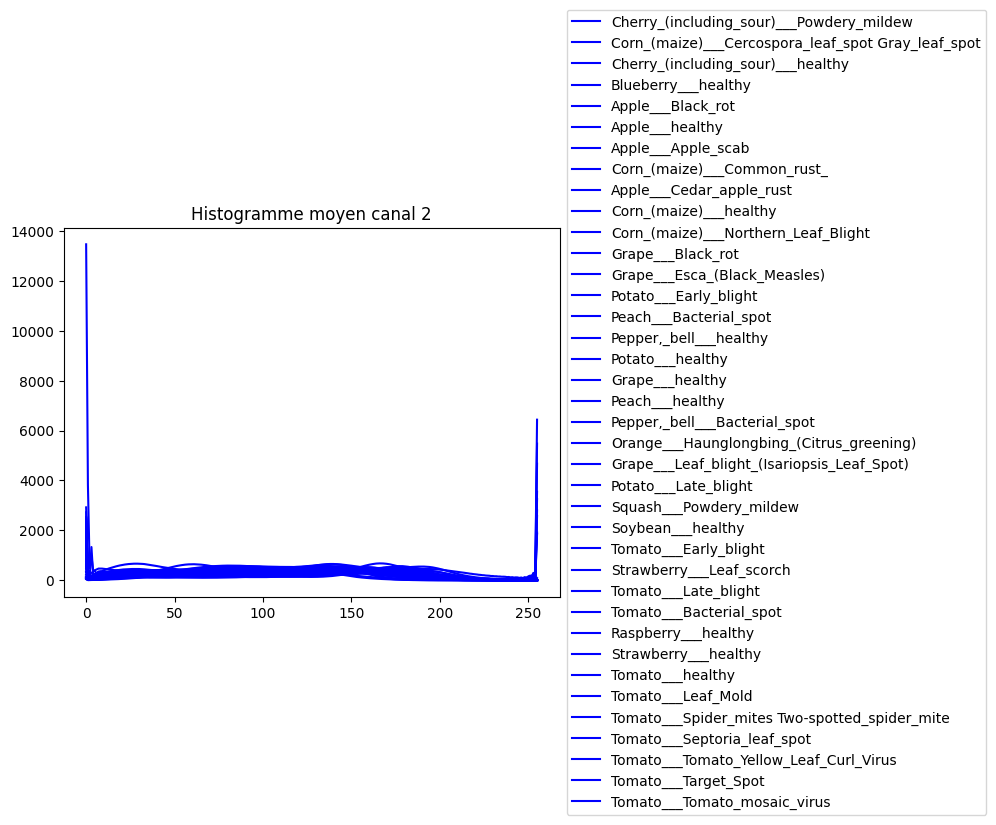

In [ ]:
# les histogrammes moyens par classe et sur les différents canaux

import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# Définir le chemin du dossier contenant les images
path_folder = "/content/drive/MyDrive/Dataset_projet/Maladie sur les plantes/New Plant Diseases/New Plant Diseases Dataset(Augmented)/train"

# Définir les noms des différentes classes
classes = os.listdir(path_folder)

# Initialiser une liste pour stocker les histogrammes moyens de chaque classe
histograms = []

# Parcourir chaque classe et calculer les histogrammes moyens de chaque canal
for class_name in classes:
    # Définir le chemin du dossier de la classe
    class_path = os.path.join(path_folder, class_name)

    # Initialiser une liste pour stocker les histogrammes moyens de chaque canal
    channel_histograms = []

    # Parcourir chaque image dans la classe
    for file_name in os.listdir(class_path):
        # Définir le chemin de l'image
        file_path = os.path.join(class_path, file_name)

        # Charger l'image
        image = Image.open(file_path)

        # Calculer l'histogramme moyen de chaque canal de l'image
        for i in range(3):
            channel_histogram = np.histogram(image.getchannel(i), bins=256, range=(0, 256))[0]
            if len(channel_histograms) <= i:
                channel_histograms.append(channel_histogram)
            else:
                channel_histograms[i] += channel_histogram

    # Diviser la somme des histogrammes par le nombre total d'images pour obtenir la moyenne
    channel_histograms = [histogram / len(os.listdir(class_path)) for histogram in channel_histograms]

    # Ajouter les histogrammes moyens de chaque canal à la liste des histogrammes de la classe
    histograms.append(channel_histograms)

# Afficher les histogrammes moyens de chaque classe pour chaque canal
colors = ['r', 'g', 'b']
for i in range(3):
    fig, ax = plt.subplots()
    ax.set_title("Histogramme moyen canal " + str(i))
    for j in range(len(classes)):
        ax.plot(histograms[j][i], color=colors[i], label=classes[j])
    # Définir la position de la légende en dehors de la figure
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    plt.show()

**Histogramme des niveaux de gris d'une image de chaque classe**

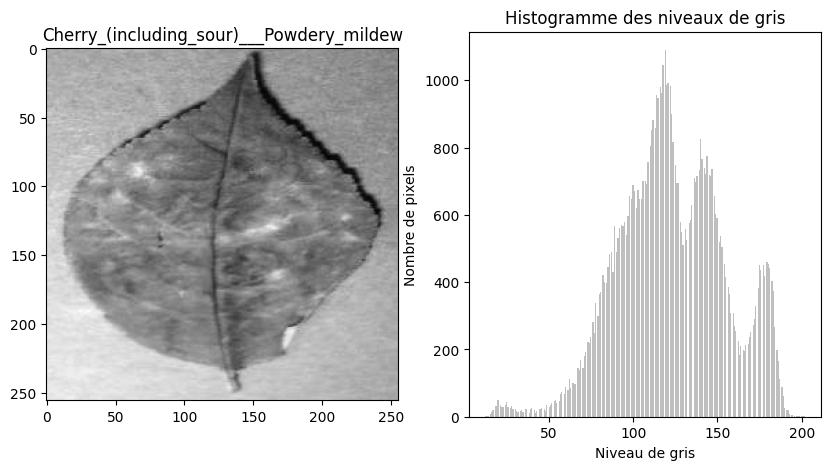

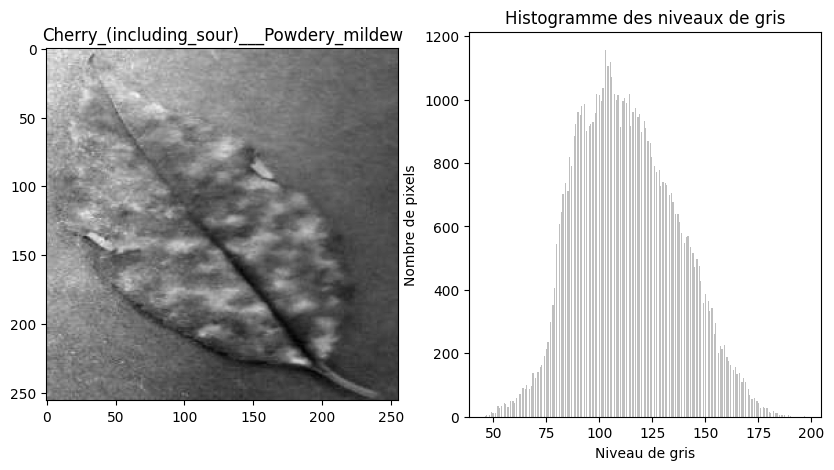

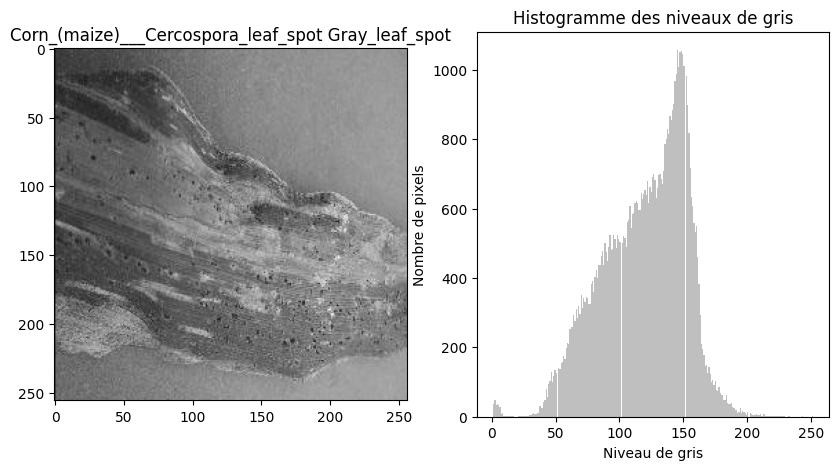

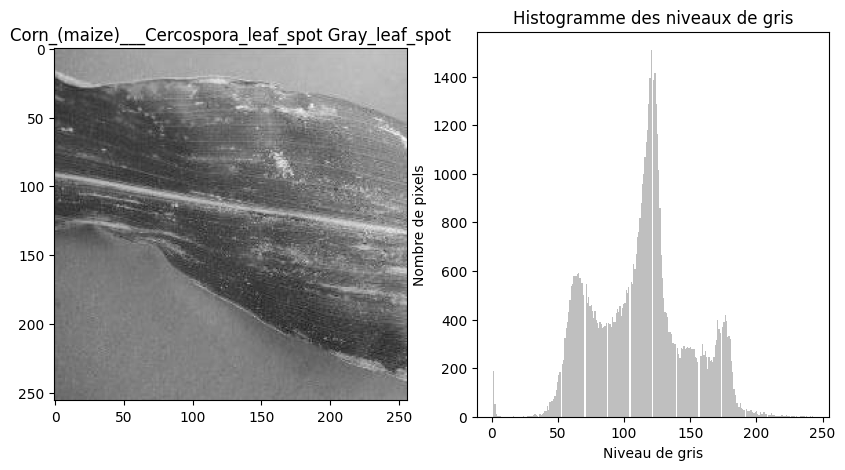

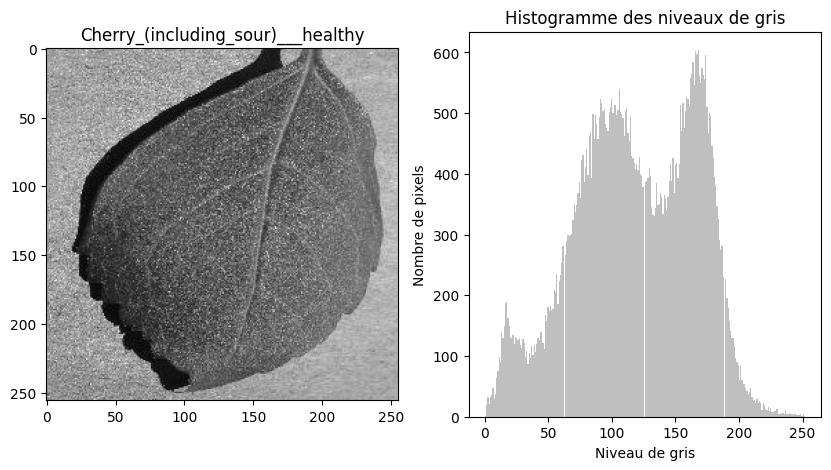

...

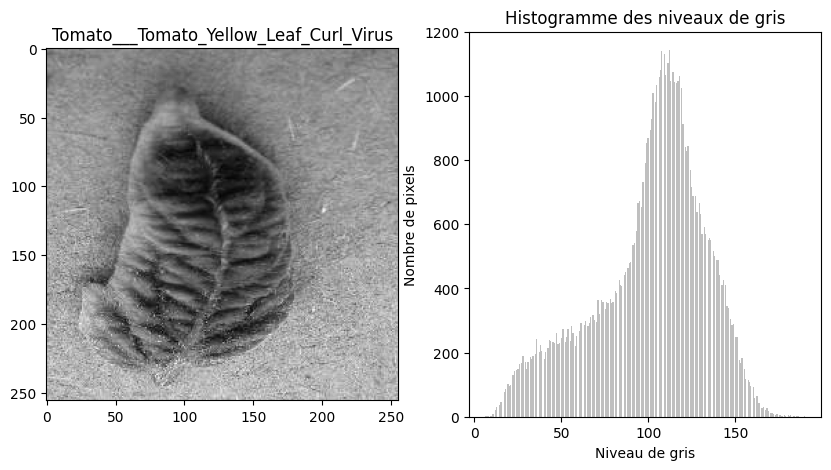

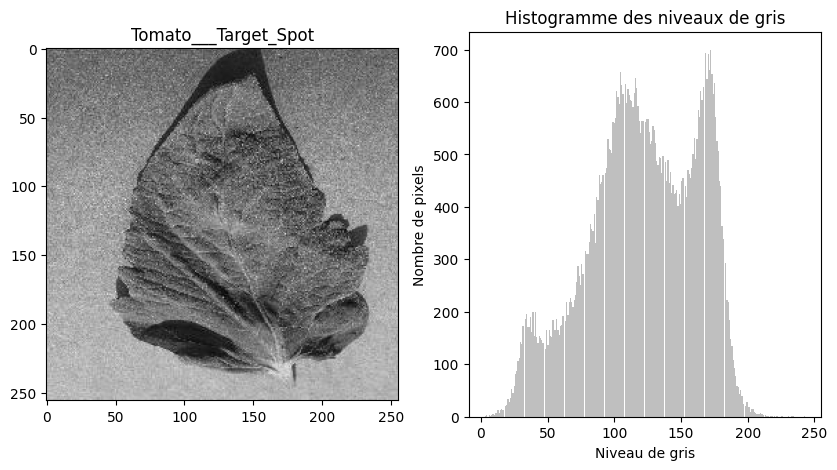

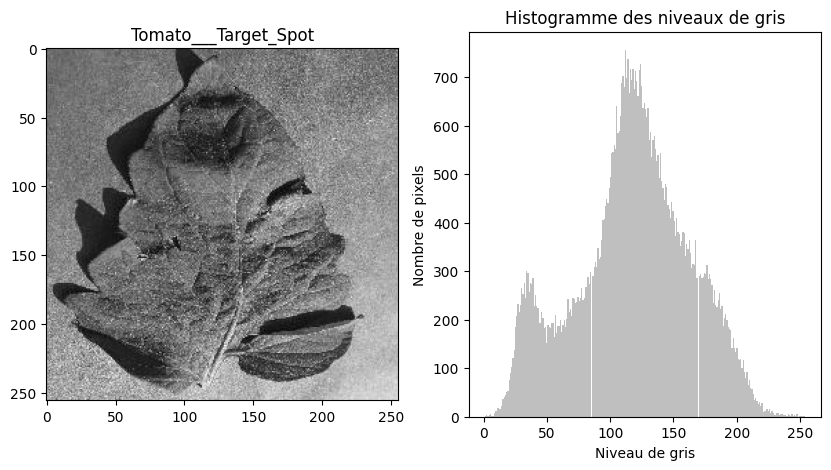

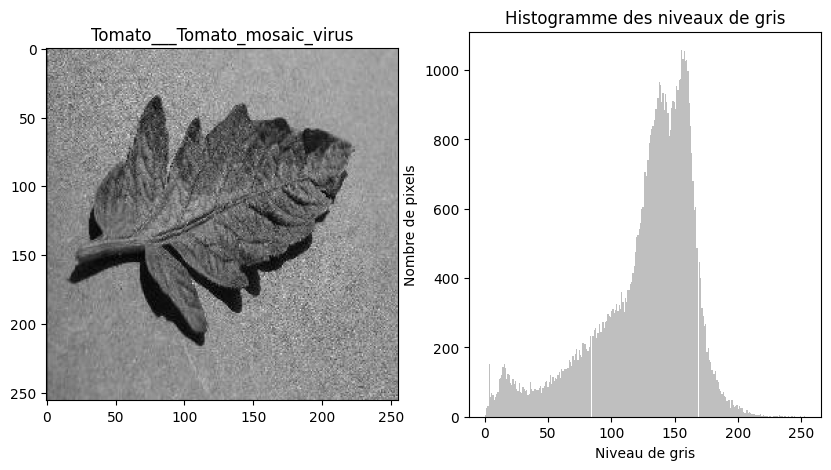

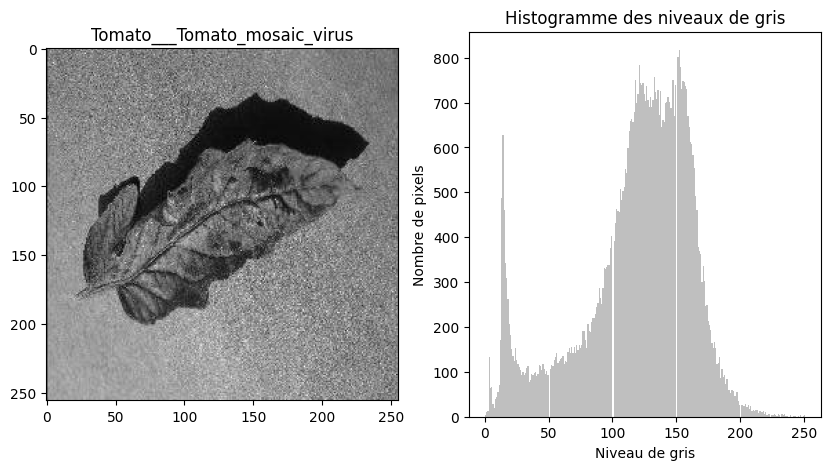

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# Chemin du dossier contenant les images
path_folder = "/content/drive/MyDrive/Dataset_projet/Maladie sur les plantes/New Plant Diseases/New Plant Diseases Dataset(Augmented)/train"

# Définition de la fonction d'affichage de l'image et de son histogramme
def show_image_and_histogram(image_path, label):
    with Image.open(image_path) as image:
        # Convertir l'image en niveau de gris
        image_gray = image.convert('L')
        intensites = np.array(image_gray).flatten()

        # Afficher l'image et son histogramme
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))
        ax1.imshow(image_gray, cmap='gray')
        ax1.set_title(label)
        ax2.hist(intensites, bins=256, color='gray', alpha=0.5)
        ax2.set_xlabel('Niveau de gris')
        ax2.set_ylabel('Nombre de pixels')
        ax2.set_title('Histogramme des niveaux de gris')
        plt.show()

# Parcourir les sous-dossiers
for class_folder in os.listdir(path_folder):
    class_path = os.path.join(path_folder, class_folder)
    if not os.path.isdir(class_path):
        continue

    # Sélectionner 2 images aléatoires
    image_files = os.listdir(class_path)
    image_files = np.random.choice(image_files, size=2, replace=False)

    # Afficher chaque image avec son histogramme
    for image_file in image_files:
        image_path = os.path.join(class_path, image_file)
        show_image_and_histogram(image_path, class_folder)

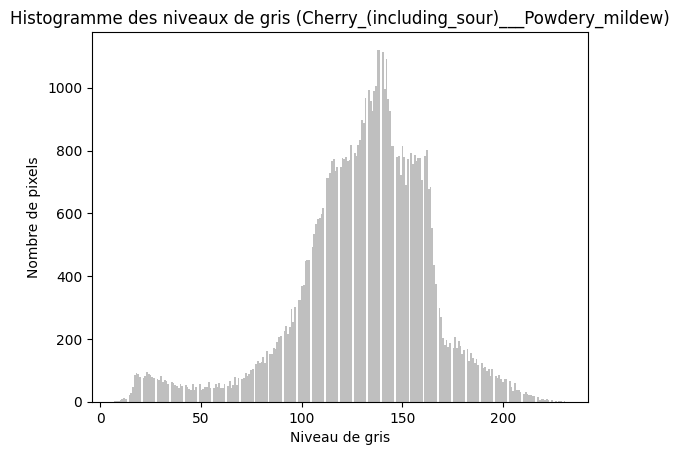

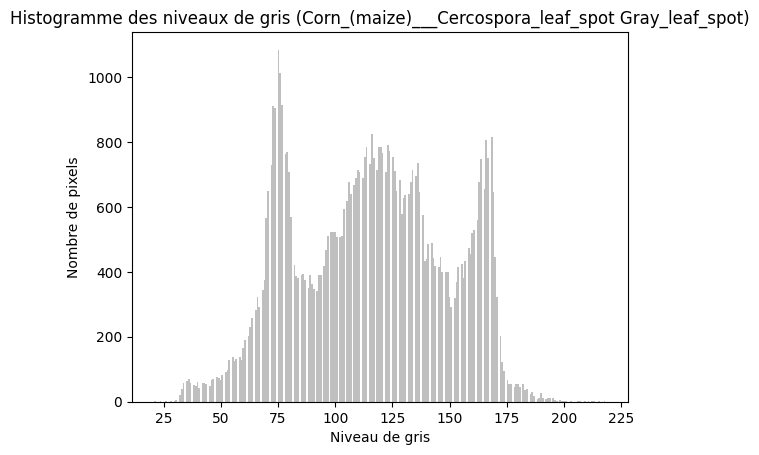

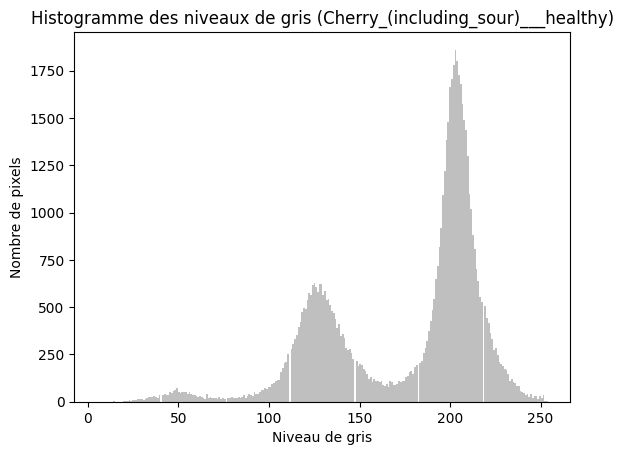

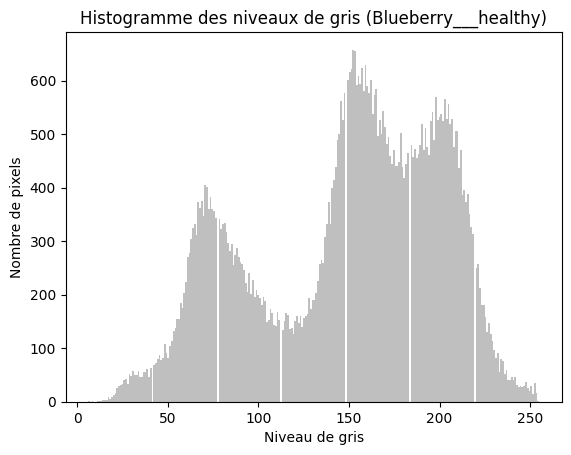

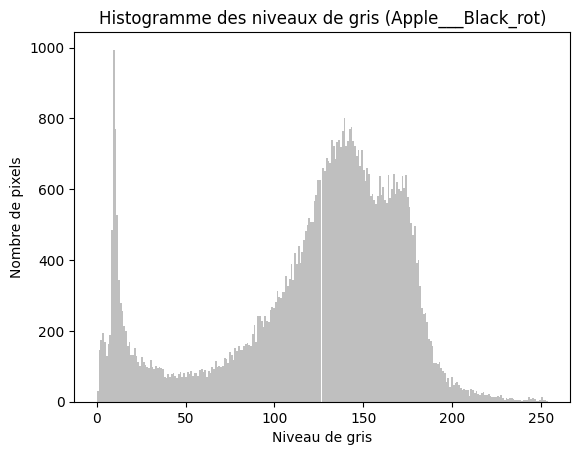

...

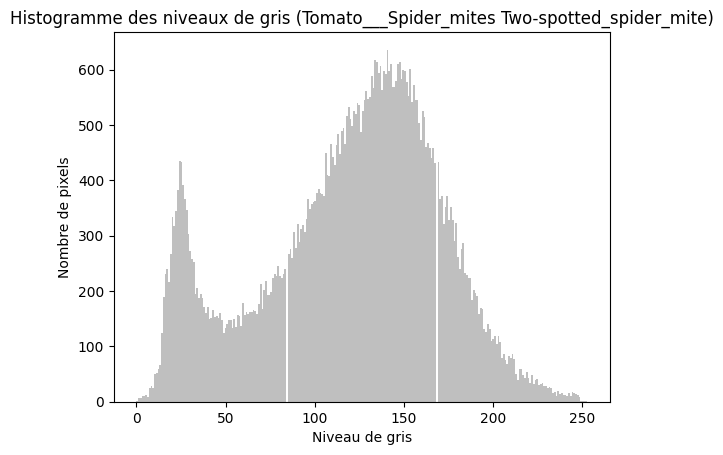

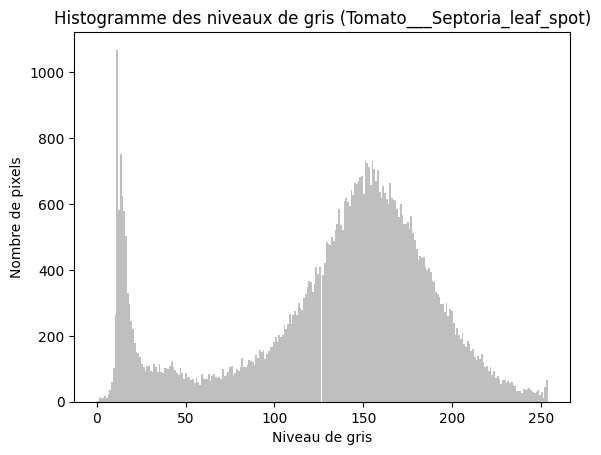

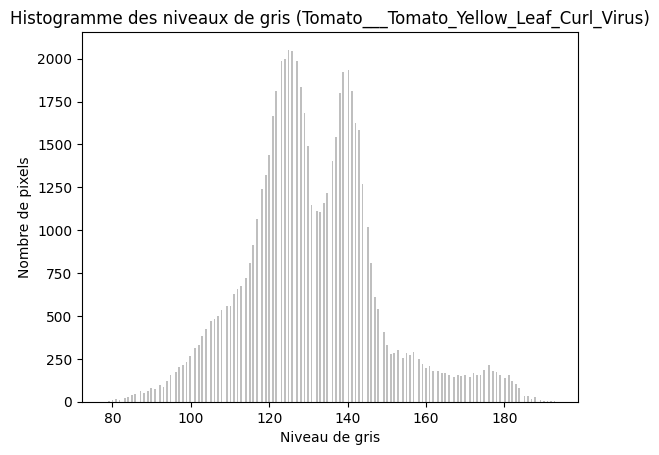

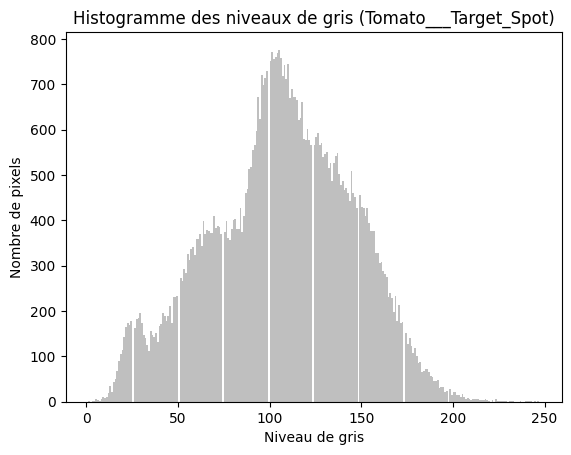

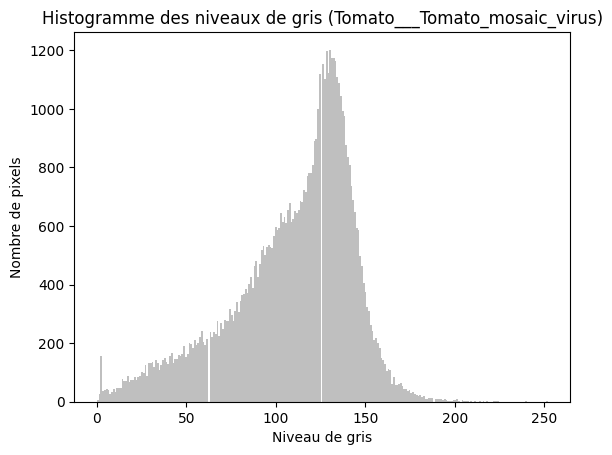

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# Chemin du dossier contenant les images
path_folder = "/content/drive/MyDrive/Dataset_projet/Maladie sur les plantes/New Plant Diseases/New Plant Diseases Dataset(Augmented)/train"

# Parcourir les sous-dossiers
for class_folder in os.listdir(path_folder):
    class_path = os.path.join(path_folder, class_folder)
    if not os.path.isdir(class_path):
        continue

    # Charger une image aléatoire
    image_files = os.listdir(class_path)
    image_file = np.random.choice(image_files)
    image_path = os.path.join(class_path, image_file)
    with Image.open(image_path) as image:
        # Convertir l'image en niveau de gris
        image_gray = image.convert('L')
        intensites = np.array(image_gray).flatten()
        # Afficher l'histogramme des niveaux de gris
        plt.hist(intensites, bins=256, color='gray', alpha=0.5)
        plt.xlabel('Niveau de gris')
        plt.ylabel('Nombre de pixels')
        plt.title(f'Histogramme des niveaux de gris ({class_folder})')
        plt.show()

    # Parcourir les sous-sous-dossiers
    for sub_folder in os.listdir(class_path):
        sub_path = os.path.join(class_path, sub_folder)
        if not os.path.isdir(sub_path):
            continue

        # Charger une image aléatoire
        image_files = os.listdir(sub_path)
        image_file = np.random.choice(image_files)
        image_path = os.path.join(sub_path, image_file)
        with Image.open(image_path) as image:
            # Convertir l'image en niveau de gris
            image_gray = image.convert('L')
            intensites = np.array(image_gray).flatten()
            # Afficher l'histogramme des niveaux de gris
            plt.hist(intensites, bins=256, color='gray', alpha=0.5)
            plt.xlabel('Niveau de gris')
            plt.ylabel('Nombre de pixels')
            plt.title(f'Histogramme des niveaux de gris ({class_folder}/{sub_folder})')
            plt.show()

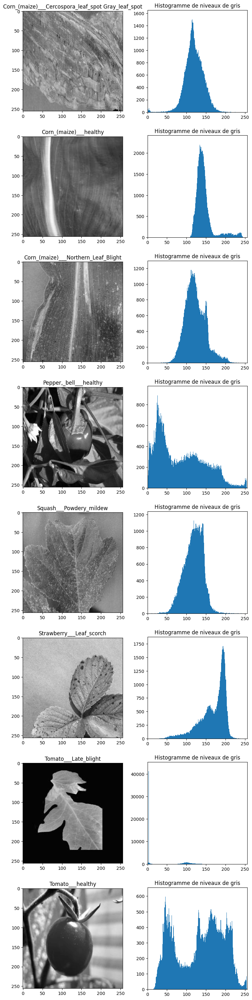

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# Chemin du dossier contenant les images
path_folder = "/content/drive/MyDrive/Dataset_projet/Maladie sur les plantes/New Plant Diseases/New Plant Diseases Dataset(Augmented)/train"

# Dictionnaire pour stocker les chemins des images aléatoires
images_dict = {}

# Parcourir les sous-dossiers et sélectionner une image aléatoire pour chaque classe
for class_folder in os.listdir(path_folder):
    class_path = os.path.join(path_folder, class_folder)
    if os.path.isdir(class_path):
        image_found = False
        for filename in os.listdir(class_path):
            if filename.endswith(".jpg"):
                image_path = os.path.join(class_path, filename)
                images_dict[class_folder] = image_path
                image_found = True
                break
        #if not image_found:
            # print(f"Aucune image trouvée pour la classe {class_folder}.")

# Afficher les images et leur histogramme de niveaux de gris
fig, axes = plt.subplots(nrows=len(images_dict), ncols=2, figsize=(8, 4*len(images_dict)))
for i, (class_folder, image_path) in enumerate(images_dict.items()):
    # Charger l'image
    image = Image.open(image_path)
    # Convertir l'image en niveaux de gris
    image_gray = image.convert("L")
    # Calculer l'histogramme de niveaux de gris
    intensites, pixels = np.histogram(np.array(image_gray).ravel(), bins=256, range=(0, 256))
    # Afficher l'image et son histogramme
    axes[i, 0].imshow(image_gray, cmap='gray')
    axes[i, 0].set_title(class_folder)
    axes[i, 1].bar(pixels[:-1], intensites, width=1)
    axes[i, 1].set_xlim(0, 256)
    axes[i, 1].set_ylim(0, np.max(intensites)*1.1)
    axes[i, 1].set_title('Histogramme de niveaux de gris')

# Ajuster les espacements entre les sous-graphiques
fig.tight_layout(pad=2.0)
plt.show()